# Advance lane lines detection project

Steps of this project are the following:
1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images. Apply a distortion correction to raw images.
2. Apply a perspective transform to rectify binary image ("birds-eye view").
3. Use color transforms, gradients, etc., to create a thresholded binary image.
4. Detect lane pixels and fit to find the lane boundary.
5. Determine the curvature of the lane and vehicle position with respect to center.
6. Warp the detected lane boundaries back onto the original image.
7. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

### Imports and helper functions

In [20]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
import matplotlib.image as mpimg
import numpy as np
import matplotlib.pyplot as plt
import cv2
import math
import glob
from IPython import display
%matplotlib inline
# %matplotlib qt

In [21]:
# display an image with title
def print_image(image, title = '', grayscale = False):
    fig = plt.figure()
    if not (title == ''):
        plt.suptitle(title + ':')
    if (grayscale):
        plt.imshow(image.squeeze(), cmap = "gray")
    else:
        plt.imshow(image.squeeze())
    plt.show()

In [22]:
# display two images
def print_two_images(img1, img2, title1 = '', title2 = '', grayscale1 = False, grayscale2 = False):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    if (grayscale1):
        ax1.imshow(img1, cmap = "gray")
    else:
        ax1.imshow(img1)    
    ax1.set_title(title1, fontsize=30)
    
    if (grayscale2):
        ax2.imshow(img2, cmap = "gray")
    else:
        ax2.imshow(img2)    
    ax2.set_title(title2, fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Processing functions:

## Image undistortion
As the first step of the image processing pipeline we need to undistort the image to remove camera distortion.

### 1. Calibrate camera
First of all, we need to calibrate the camera basing on images of the chess board taken on the flat surface. We will calculate image and object points - coordinates of inner corners of the chess board on the image and normalized coordinates.

I start by preparing "object points", which will be the (x, y, z) coordinates of the chessboard corners in the world. Here I am assuming the chessboard is fixed on the (x, y) plane at z=0, such that the object points are the same for each calibration image. Thus, `objp` is just a replicated array of coordinates, and `objpoints` will be appended with a copy of it every time I successfully detect all chessboard corners in a test image. `imgpoints` will be appended with the (x, y) pixel position of each of the corners in the image plane with each successful chessboard detection.

I then used the output `objpoints` and `imgpoints` to compute the camera calibration and distortion coefficients using the cv2.calibrateCamera() function.

In [23]:
# function for creating of object points and image points. Takes photo paths with chess board and size of 
# the board (amount of inner corners)
def calibrate_camera(image_files_mask = './camera_cal/calibration*.jpg', x_chess_size = 9, y_chess_size=6):
    images = glob.glob(image_files_mask)

    objpoints = []
    imgpoints = []

    # get, let z=0
    objp = np.zeros((x_chess_size*y_chess_size,3), np.float32)
    objp[:,:2] = np.mgrid[0:x_chess_size,0:y_chess_size].T.reshape(-1,2)

    # get chessboard corners for every image
    for file in images:
        img = mpimg.imread(file)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        ret, corners = cv2.findChessboardCorners(gray, (x_chess_size, y_chess_size), None)

        if ret == True:
            imgpoints.append(corners)
            objpoints.append(objp)

    print("Final points size: {0}, {1}".format(len(objpoints), len(imgpoints)))    
    return (objpoints, imgpoints)

### 2. Undistort image

In [24]:
def cal_undistort(img, objpoints, imgpoints):
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

### 3. Test
Lets see how good calculated image points are on calibration and test images from the car.

Final points size: 17, 17


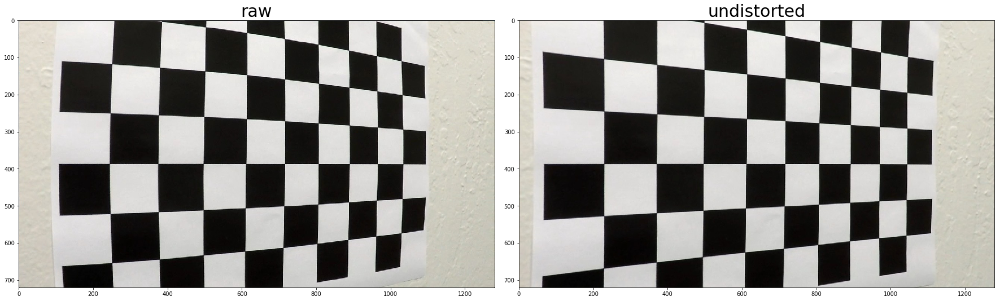

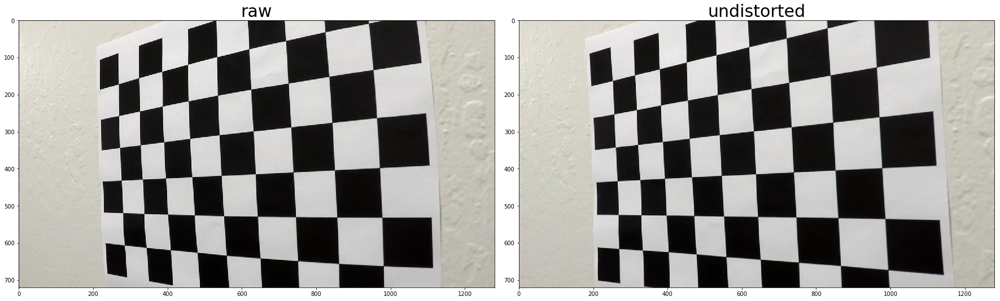

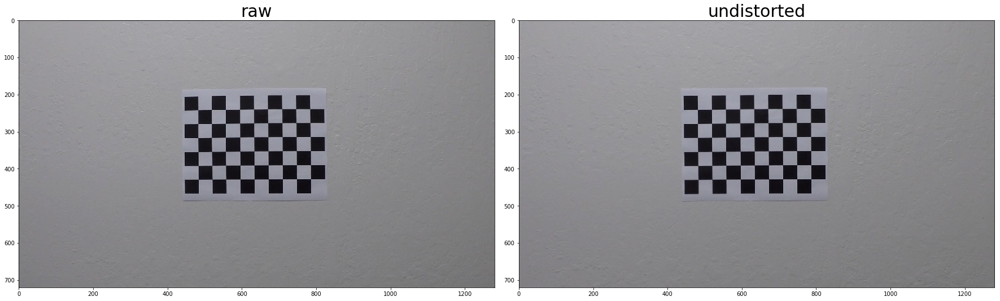

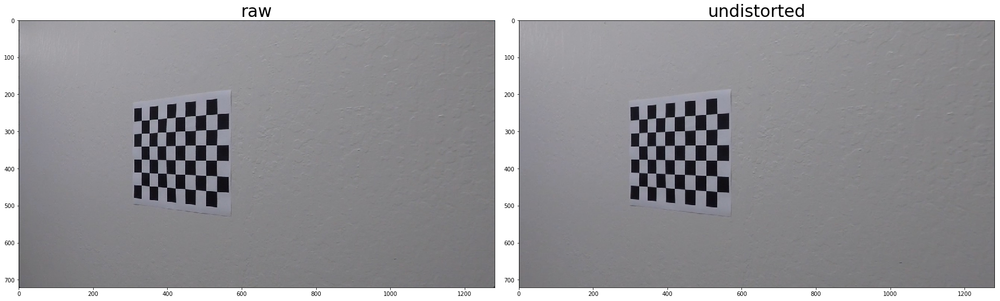

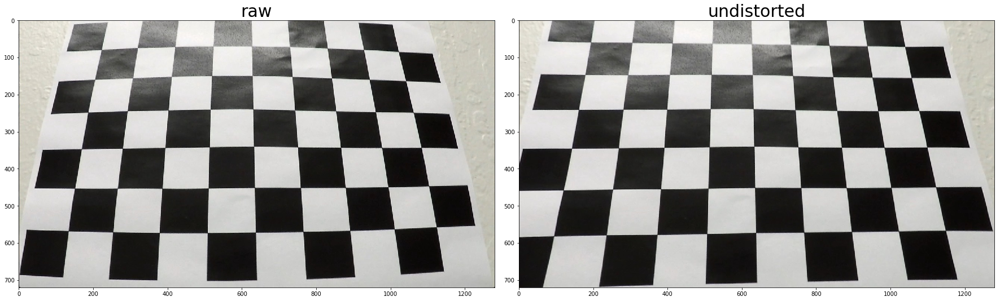

...

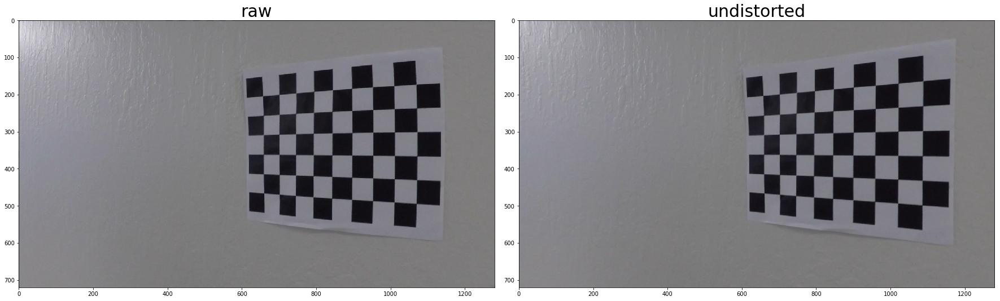

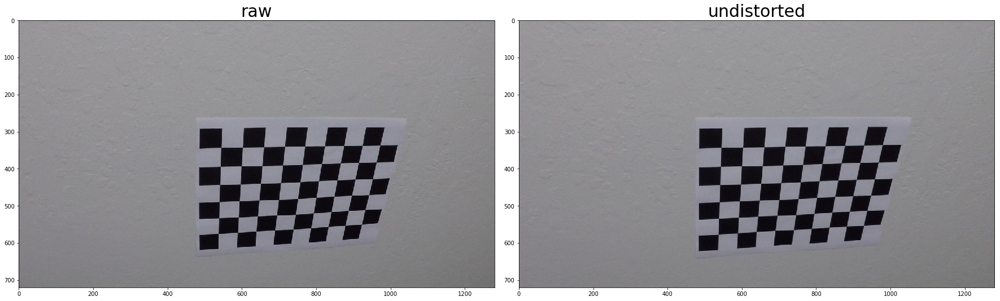

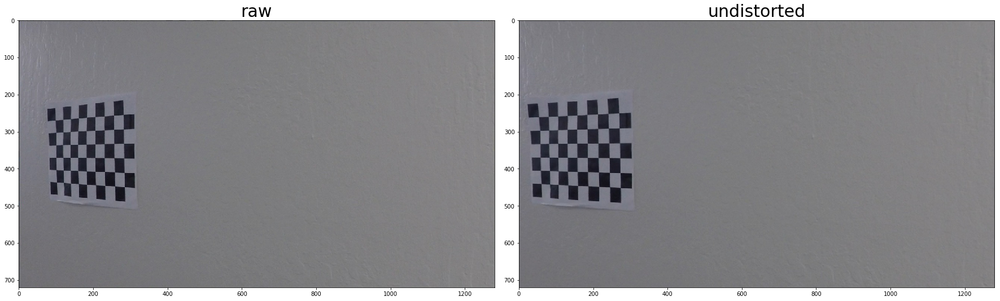

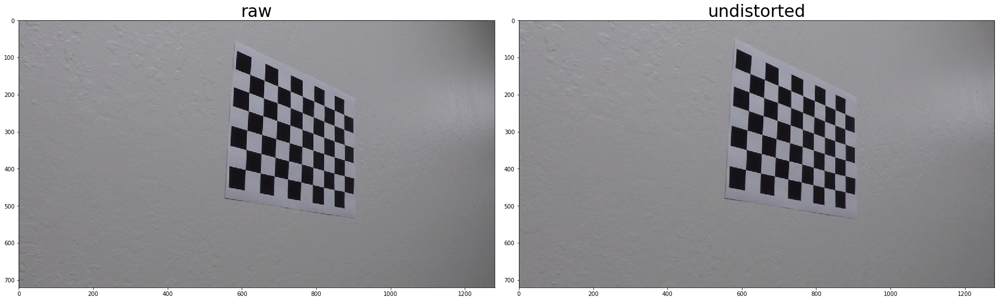

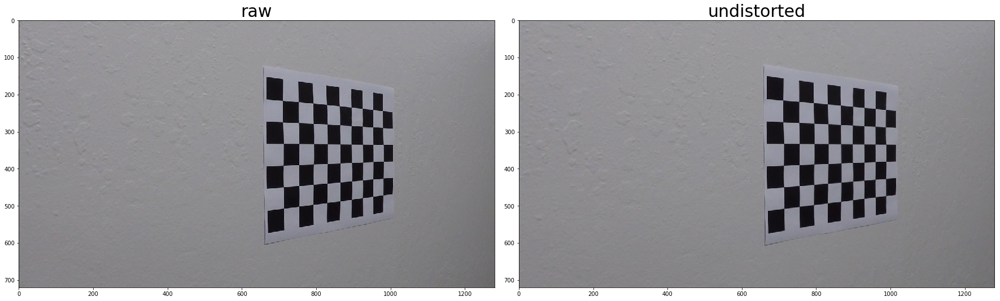

In [25]:
(objpoints, imgpoints) = calibrate_camera()

images = glob.glob('./camera_cal/calibration*.jpg')
for image in images:
    img = mpimg.imread(image)
    res = cal_undistort(img, objpoints, imgpoints)
    print_two_images(img, res, "raw", "undistorted")

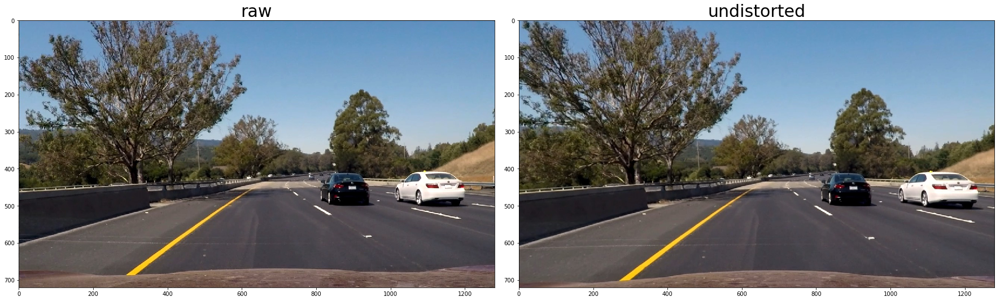

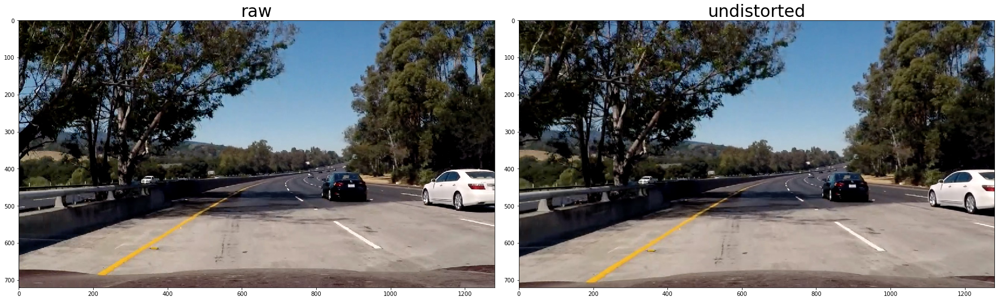

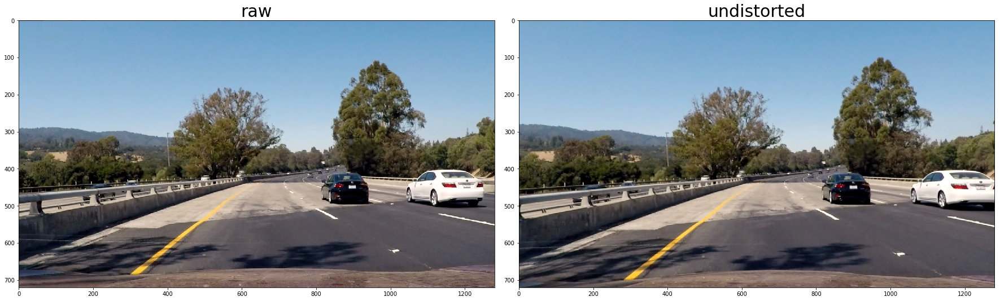

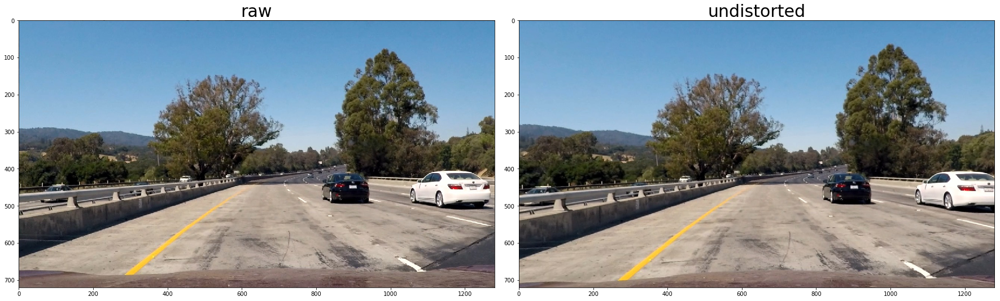

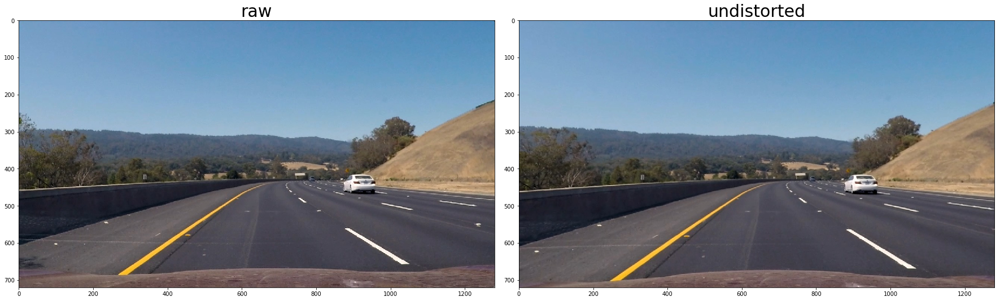

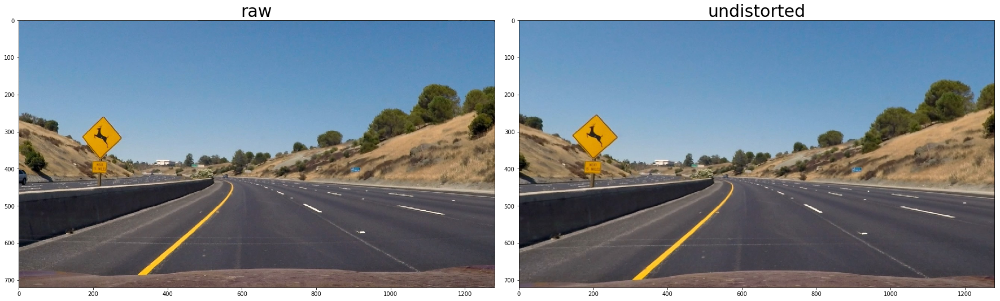

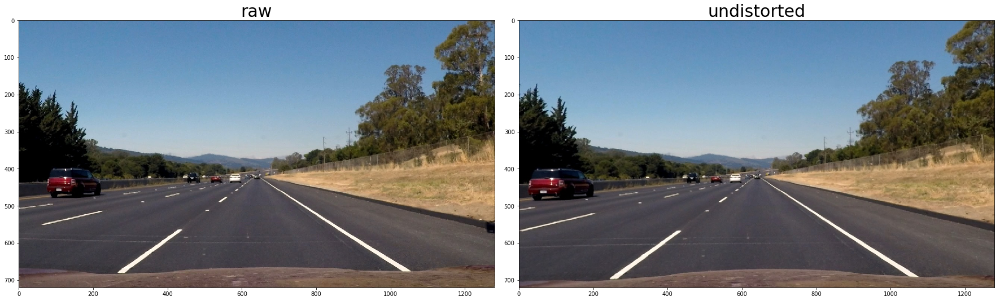

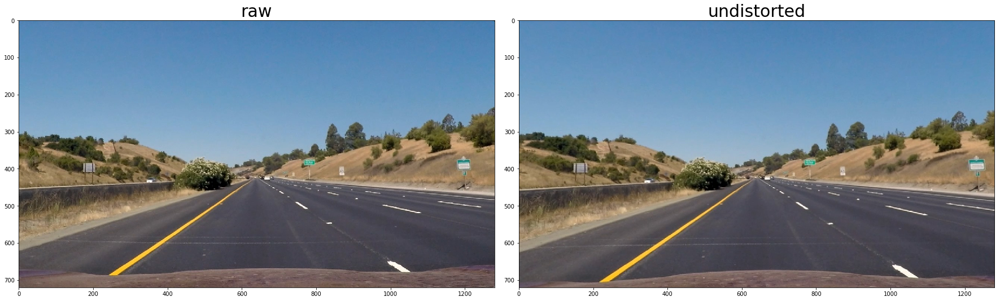

In [26]:
images = glob.glob('./test_images/*.jpg')
for image in images:
    img = mpimg.imread(image)
    res = cal_undistort(img, objpoints, imgpoints)
    print_two_images(img, res, "raw", "undistorted")

## Bird-eye transformation
As the next step we want to apply image perspective transformation to make "bird eye" view. In this case lane lines become parallel and it would be easier to calculate shape of lane lines. 

In order to perform this transformation I took one photo from the front camera where lines are parallel and calculated the coefficients for image transformation by taking coordinates of the left and right line near the car and on some distance. Probably this method will not work on hills and for smarter solution we need to smth more advanced with usage of sensors. 

During this transofrmation I also change size of the image to make it more vertical so it will be easier for my pipeline to detect lane lines.

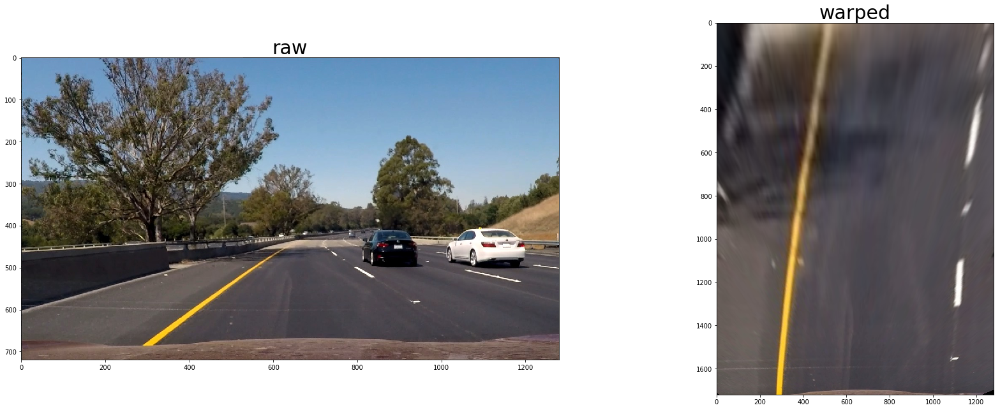

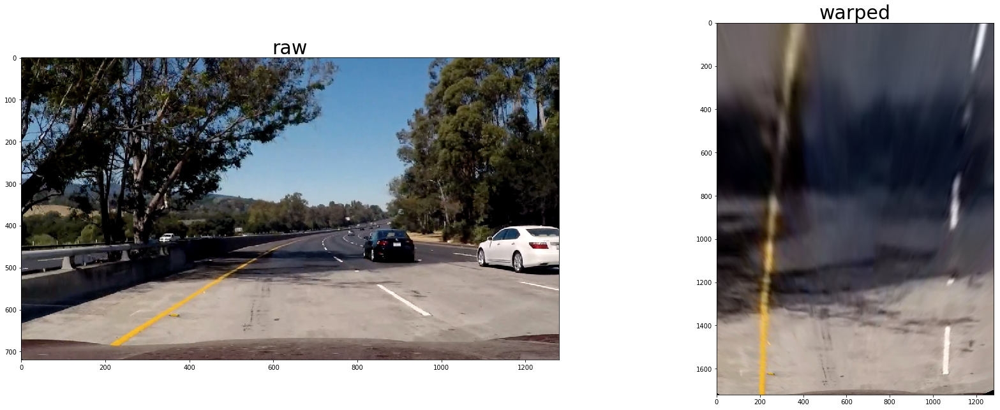

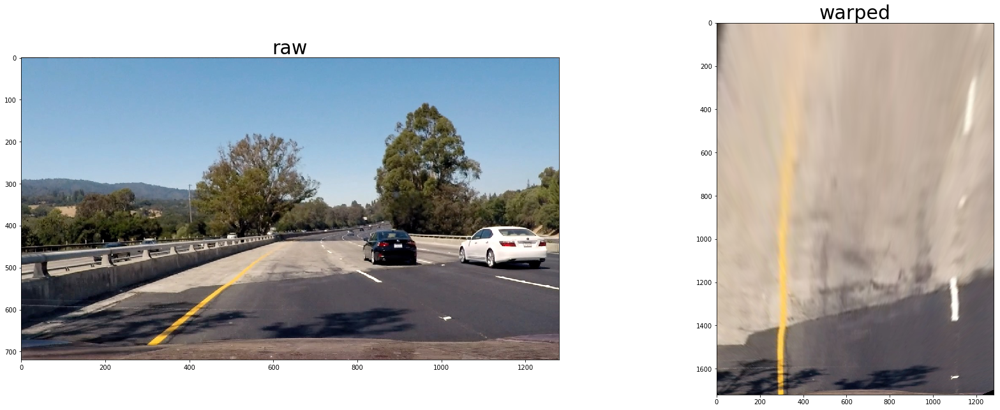

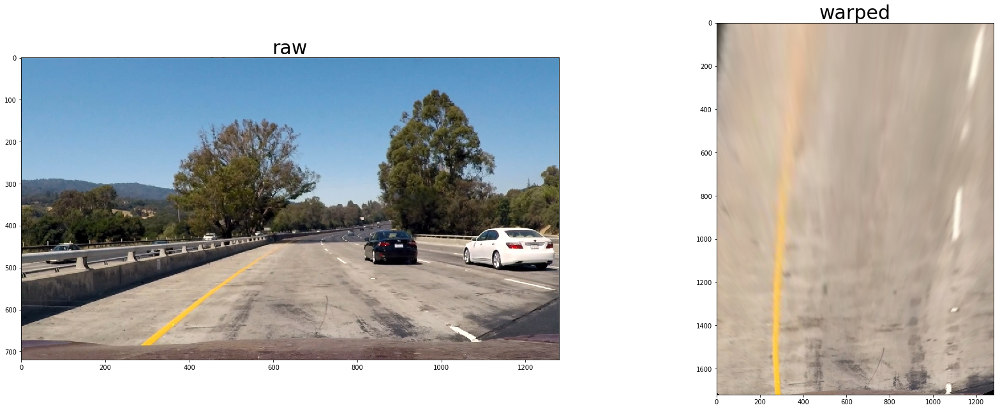

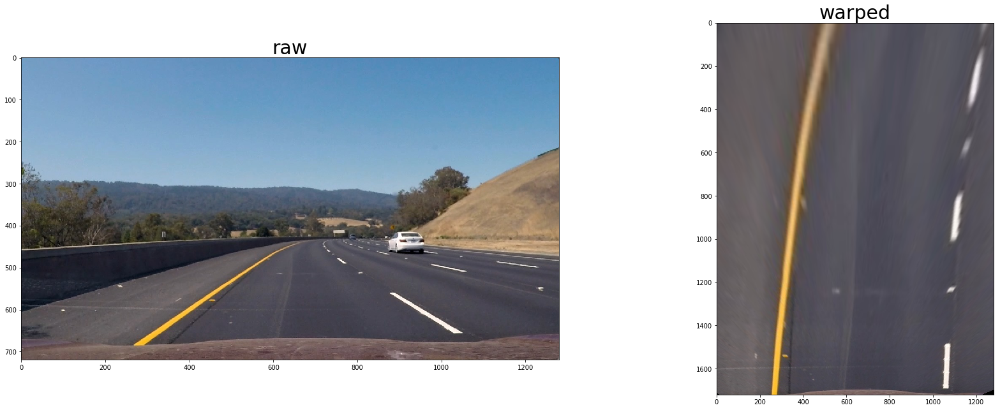

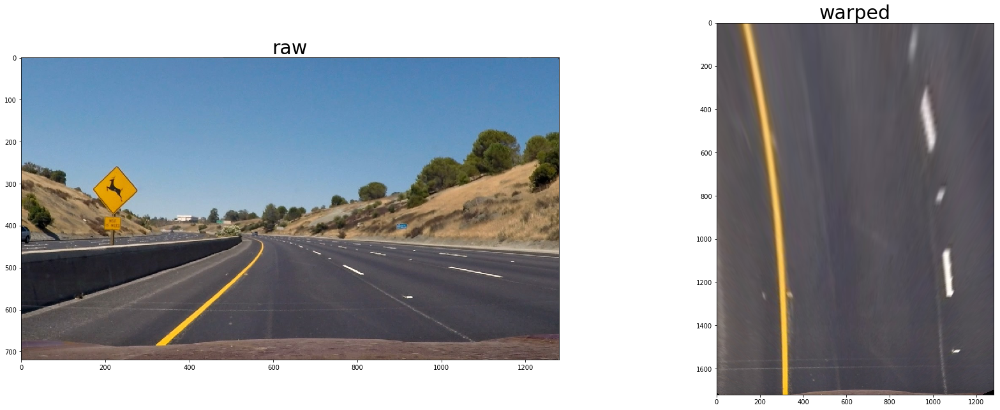

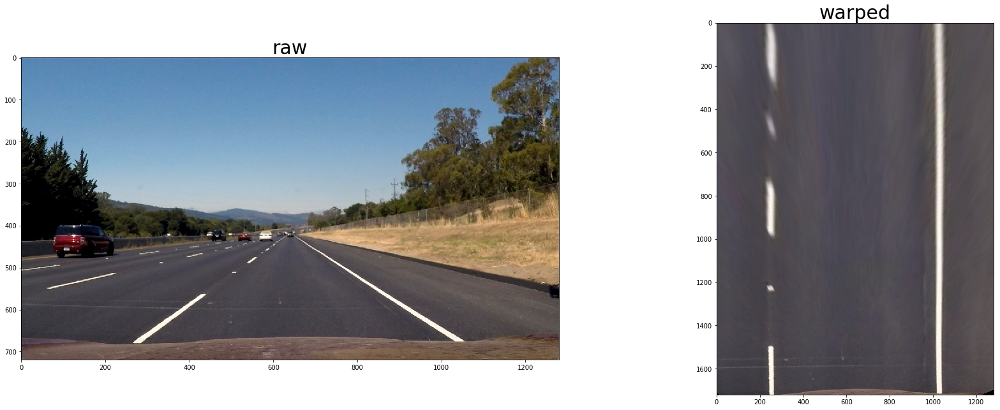

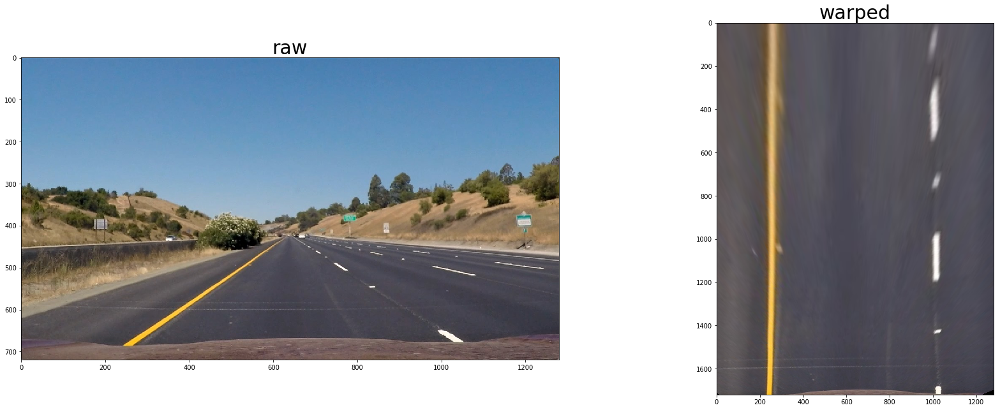

In [27]:
def transform_bird_eye(img, reverse = False):
    x_res = 1280
    y_res = 1720
    x_source = 1280
    y_source = 720
    
    x_offset = round(x_res/5)
    y_offset = 0
    src = np.float32([[254,697], [590,454], [695,454], [1070, 697]]) # TODO: adjust to center
    dst = np.float32([[x_offset, y_res - y_offset], [x_offset, y_offset], [x_res - x_offset, y_offset], 
                        [x_res - x_offset, y_res - y_offset]])
    
    # Given src and dst points, calculate the perspective transform matrix
    # Warp the image using OpenCV warpPerspective()
    if reverse:
        M = cv2.getPerspectiveTransform(dst, src)
        return cv2.warpPerspective(img, M, (x_source,y_source))
    else: 
        M = cv2.getPerspectiveTransform(src, dst)
        return cv2.warpPerspective(img, M, (x_res,y_res))    

images = glob.glob('./test_images/*.jpg')
for image in images:
    img = mpimg.imread(image)
    undist = cal_undistort(img, objpoints, imgpoints)
    warped = transform_bird_eye(undist)
    print_two_images(img, warped, "raw", "warped")

## Thresholding
As the next step I apply different techniques to get a thresholded image where white pixels will represent lane lines and black will be all the rest.

### 1. Apply Sobel operator
The Sobel operator is at the heart of the Canny edge detection algorithm. As soon as I apply it to warped "bird-eye" view image, my lane lines are located vertically, I can take gradients only in x direction.

To apply Sobel operator I convert the image to HLS space and apply it to lightness channel. I tried to apply it to other channels and apply to grayscaled image, but my approach gives better results.

In [28]:
def apply_sobel(img, channel, sx_thresh):
    # Sobel x
    sobelx = cv2.Sobel(channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    return sxbinary

def get_threshold_all(img, sx_thresh=(20, 100)):
    img = np.copy(img)

    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]

    h_sobel = apply_sobel(img, h_channel, sx_thresh)
    l_sobel = apply_sobel(img, l_channel, sx_thresh) 
    s_sobel = apply_sobel(img, s_channel, sx_thresh) 

    return (h_sobel, l_sobel, s_sobel)

def get_threshold_l(img, sx_thresh=(20, 100)):
    img = np.copy(img)

    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hls[:,:,1]

    l_sobel = apply_sobel(img, l_channel, sx_thresh) 

    return l_sobel

### 2. Apply color thresholding
I convert the image to HLS space and apply color thresholding to saturation channel. 

In [29]:
def get_saturation_threshold(img, s_thresh=(185, 255)):
    img = np.copy(img)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    s_channel = hls[:,:,2]
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1

    return s_binary

### 3. Clean noize
Some objects on the image could be concidered as not lane lines even now. I remove all white horisontal lines that are longer than width of lane line.

In [30]:
def clean_noize(img, threshold = 50):
    img = np.copy(img)
    res_img = []

    for line in img:
        flat_counter = 0
        x = 0
        for point in line:
            x = x + 1 
            if point == 1:
                flat_counter = flat_counter + 1
            else:
                if flat_counter > threshold:
                    line[x + 1 - flat_counter: x + 1] = 0
                    flat_counter = 1
        res_img.append(line)
    
    return np.array(res_img)

### Test image thresholding
First of all lets see what every step gives us in the result:

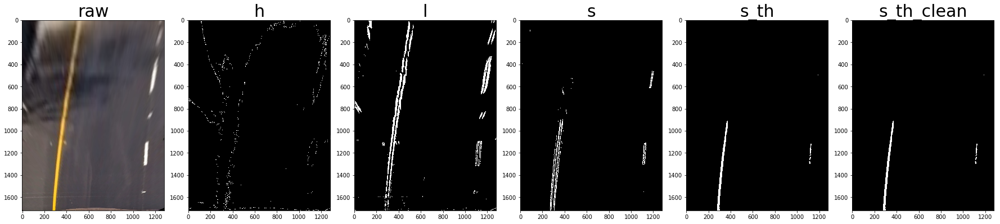

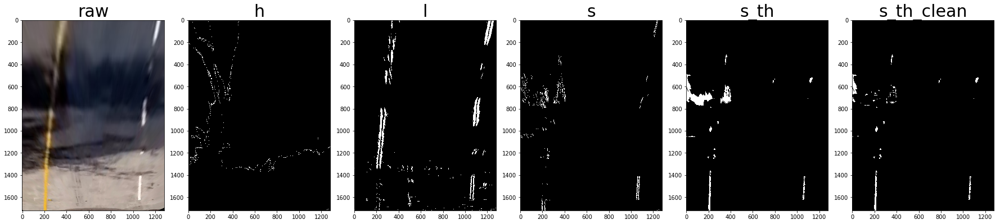

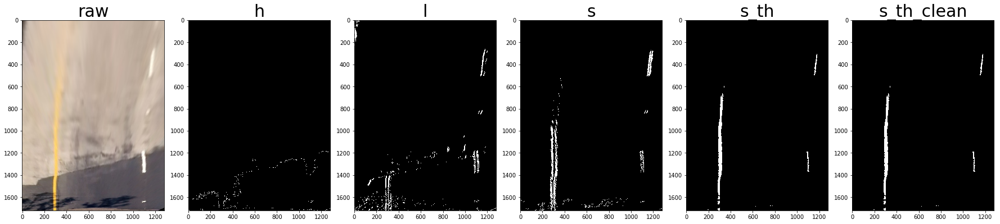

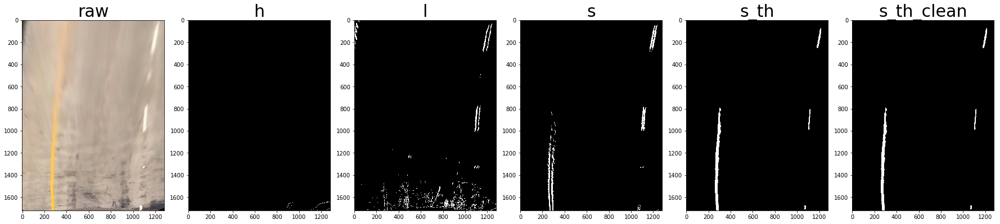

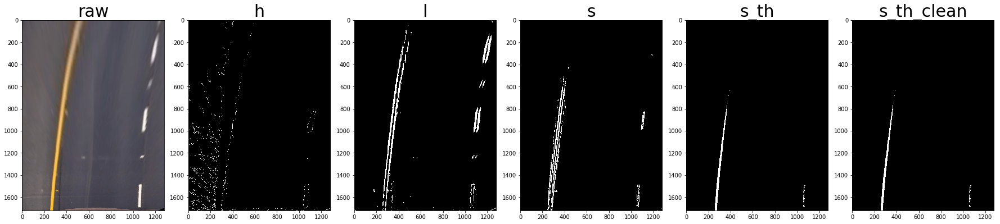

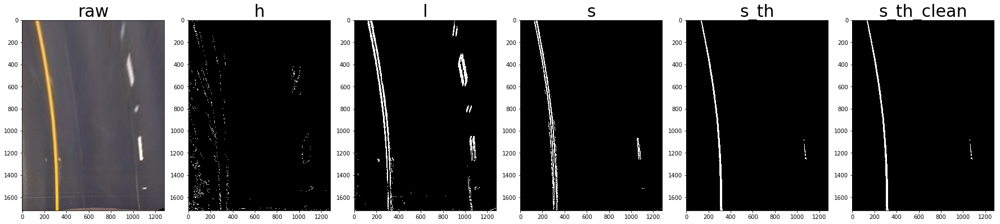

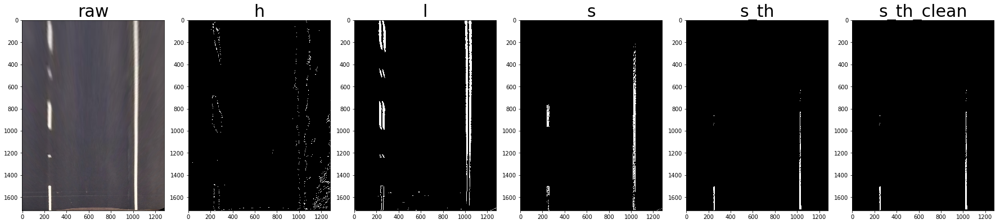

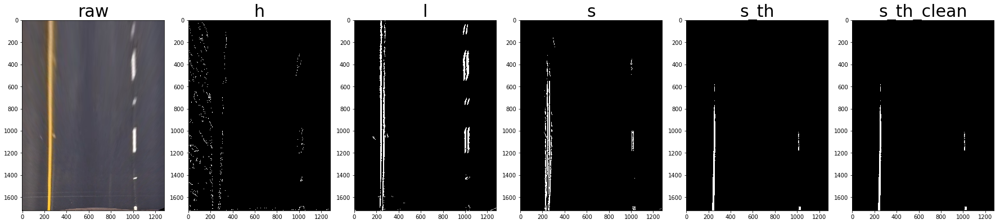

In [31]:
images = glob.glob('./test_images/*.jpg')
for image in images:
    img = mpimg.imread(image)
    undist = cal_undistort(img, objpoints, imgpoints)
    trans = transform_bird_eye(undist)
    gaus = cv2.GaussianBlur(trans, (5, 5), 0)
    (h,l,s) = get_threshold_all(gaus)
    s_th = get_saturation_threshold(gaus)
    s_th_clean = clean_noize(s_th)
    
    f, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(1, 6, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(trans)    
    ax1.set_title("raw", fontsize=30)

    ax2.imshow(h, cmap = "gray")    
    ax2.set_title("h", fontsize=30)

    ax3.imshow(l, cmap = "gray")    
    ax3.set_title("l", fontsize=30)

    ax4.imshow(s, cmap = "gray")    
    ax4.set_title("s", fontsize=30)

    ax5.imshow(s_th, cmap = "gray")    
    ax5.set_title("s_th", fontsize=30)

    ax6.imshow(s_th_clean, cmap = "gray")    
    ax6.set_title("s_th_clean", fontsize=30)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    # print_two_images(trans, grad, "raw", "undistorted", False, True)

We see that lightness channel with applied Sobel operator and saturation thresholded image returns us almost whole lane line. 

### 4. Combine all together
Now we can combine all thresholded images and apply noize reduction

In [34]:
def get_thresholded_image(img):
    l = get_threshold_l(img)
    s = get_saturation_threshold(img)
    
    s_noize = clean_noize(s)
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(s_noize)
    combined_binary[(l == 1) | (s_noize == 1)] = 1
    
    return combined_binary

### Test images
Now lets run thresholding on test images.

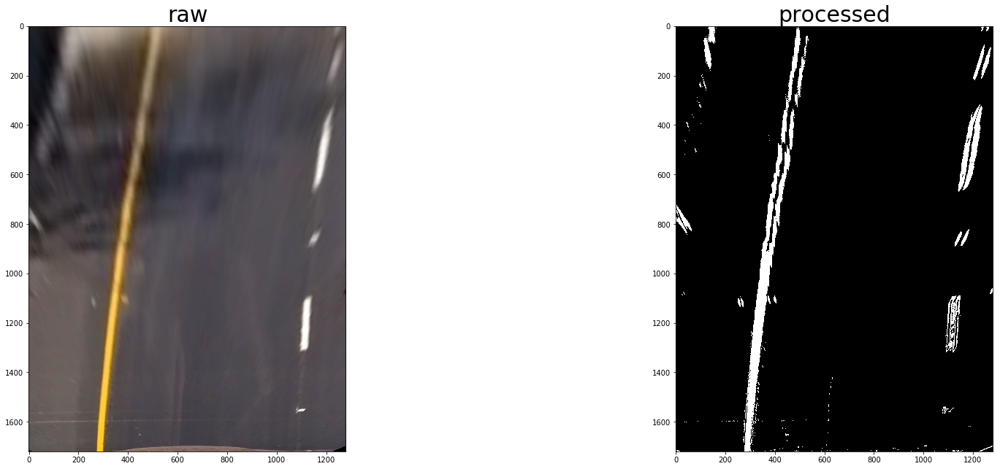

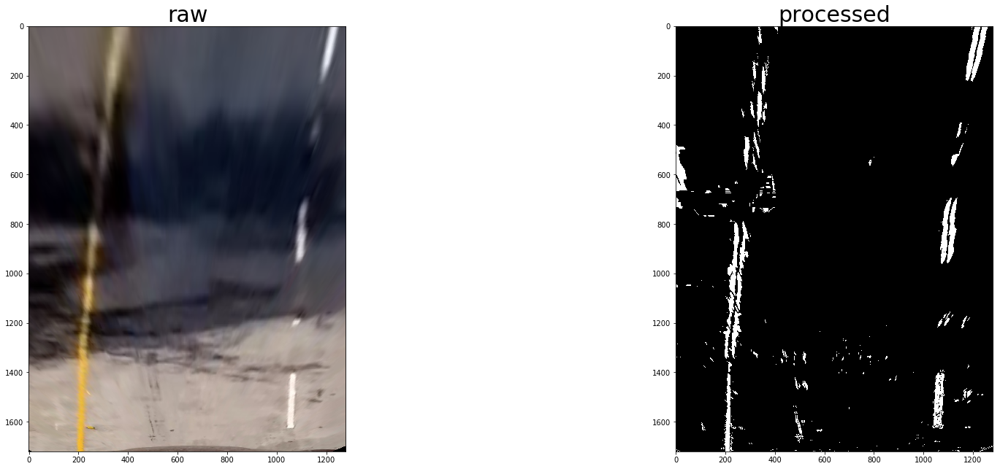

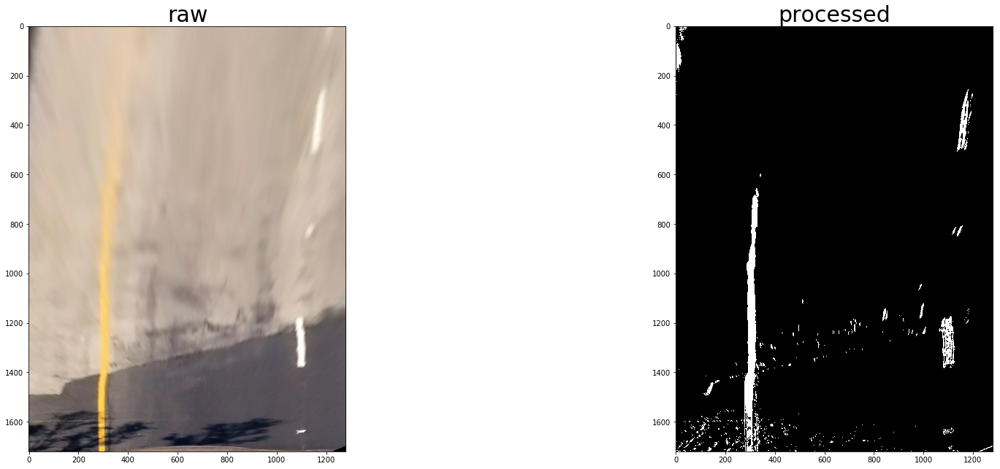

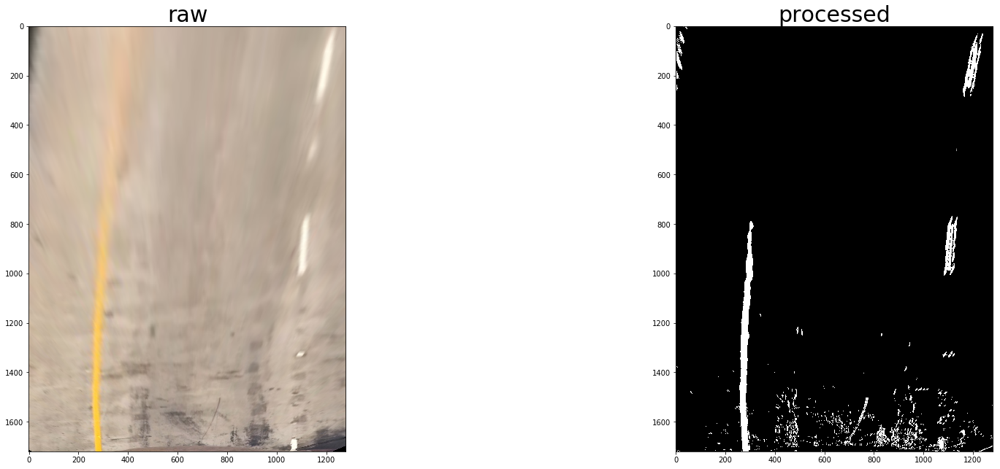

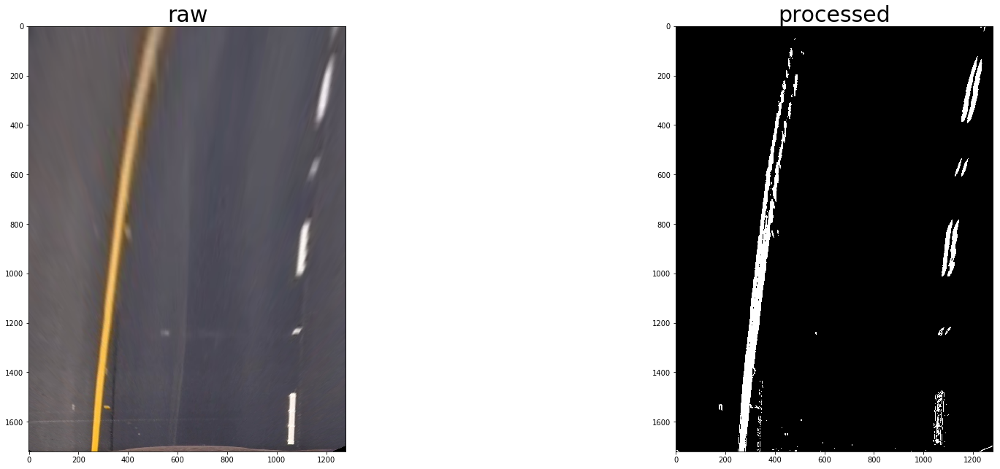

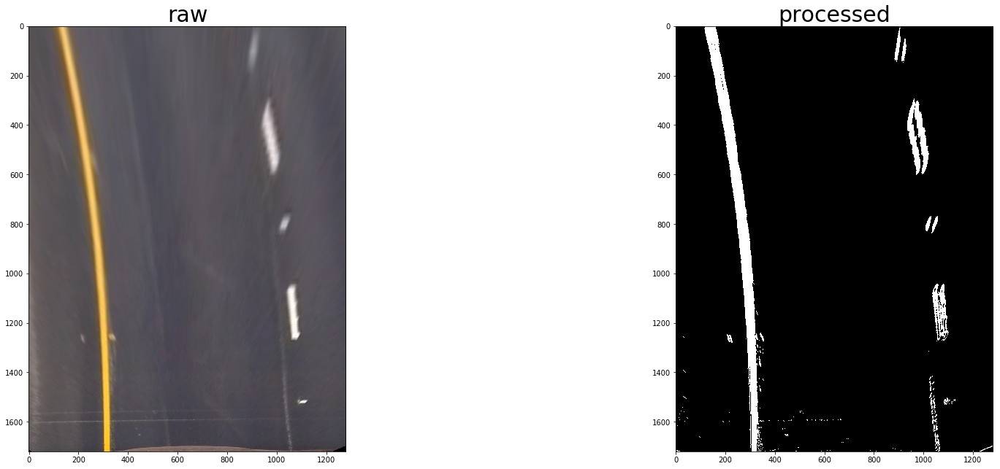

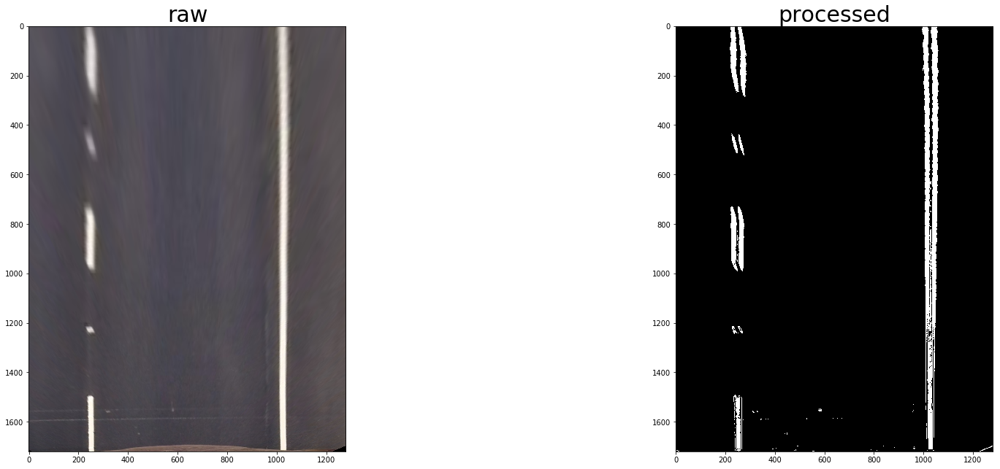

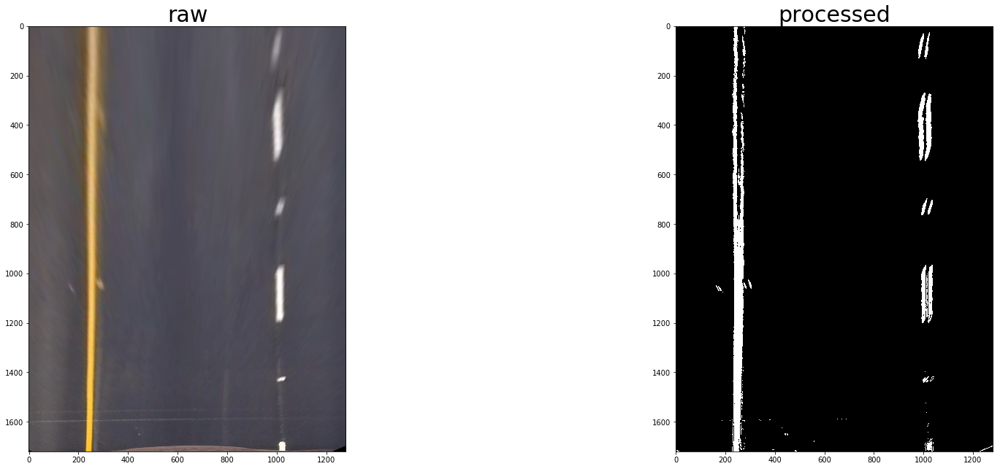

In [35]:
images = glob.glob('./test_images/*.jpg')
i = 0
for image in images:
    i = i + 1
    img = mpimg.imread(image)
    undist = cal_undistort(img, objpoints, imgpoints)
    warped = transform_bird_eye(undist)
    gaus = cv2.GaussianBlur(warped, (5, 5), 0)
    thresholded = get_thresholded_image(gaus)
    mpimg.imsave("./output_images/thesholded_{0}.jpg".format(i), thresholded)
    print_two_images(warped, thresholded, "raw", "processed", False, True)
    

## Lane lines detection
As soon as we have thresholded image with lane lines on it, we can detect them. As the result I return coefficients `A`, `B` and `C` of the curve function `f(y) = A*y**2 + B*y + C`

In [15]:
def get_all_max_from_histogram(histogram, threshold):  
    res = []
    step = 30
    histogram = np.copy(histogram)
    while True:
        x_base = np.argmax(histogram[:])
        
        if histogram[x_base] > threshold:
            res.append(x_base)
            histogram[max(1, x_base - step):min(len(histogram),x_base + step)] = 0
        else:
            return np.array(res)
    return np.array(res)

def get_lane_lines(binary_warped, nwindows = 15, margin = 50, minpix = 50):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    
    # I expect car to be between lane lines for this project, so I can assume the location of them 
    # on left and right side and can clean center of the histogram and borders
    blank_zone = 80
    histogram[1:blank_zone] = 0
    histogram[len(histogram)-blank_zone:len(histogram)] = 0
    histogram[midpoint - blank_zone*3:midpoint + blank_zone*3] = 0

    # get all peaks of the histogram of the left and right halfes of the image that are > than threshold
    hist_low_threshold = 80
    leftx_max = get_all_max_from_histogram(histogram[:midpoint], hist_low_threshold)
    rightx_max = get_all_max_from_histogram(histogram[midpoint:], hist_low_threshold) + midpoint
    
    # iterate over all max, get prediction what peaks belongs to lane lines
    avg_dist_between_lines = 800
    leftx_base = np.argmax(100)
    rightx_base = np.argmax(len(histogram) - 100) + midpoint
                                            
    win_distance = 1000
    for left in leftx_max:
        for right in rightx_max:
            distance = abs(avg_dist_between_lines - right + left)
            if distance < win_distance:
                win_distance = distance
                leftx_base = left
                rightx_base = right
    
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    return (left_fit, right_fit, histogram)

### Display images and used histogram

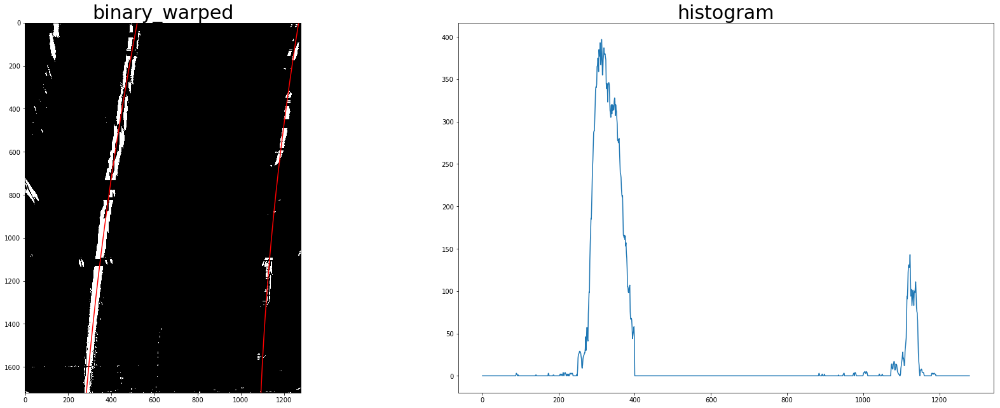

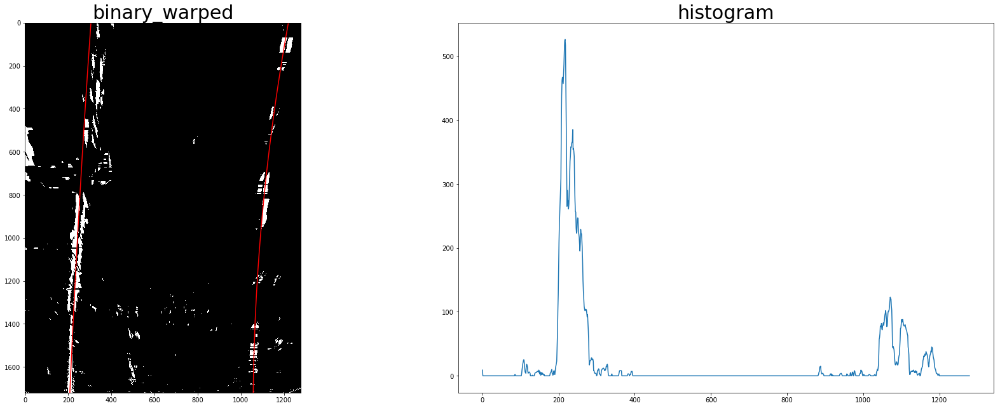

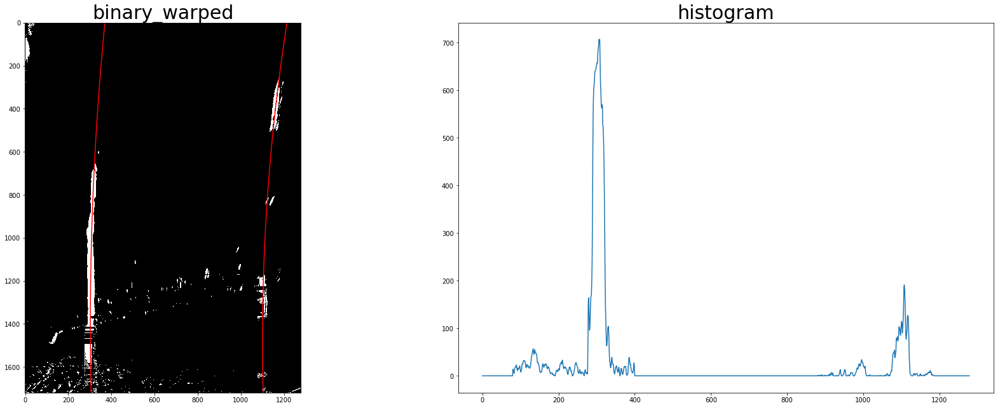

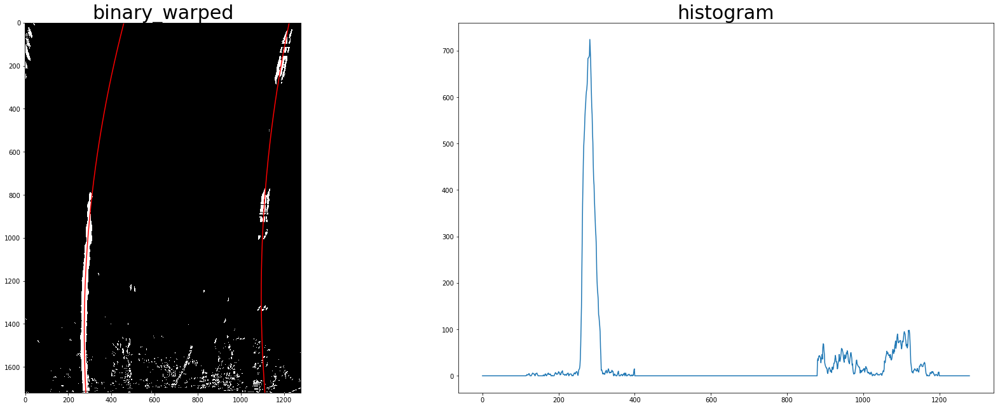

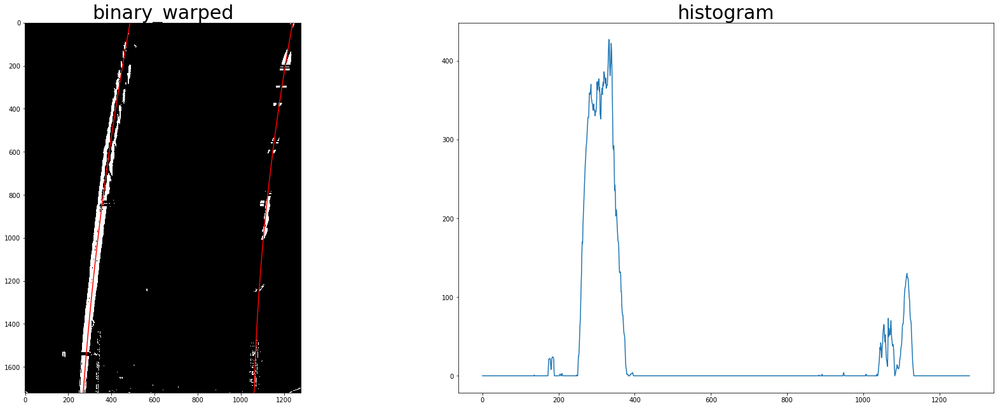

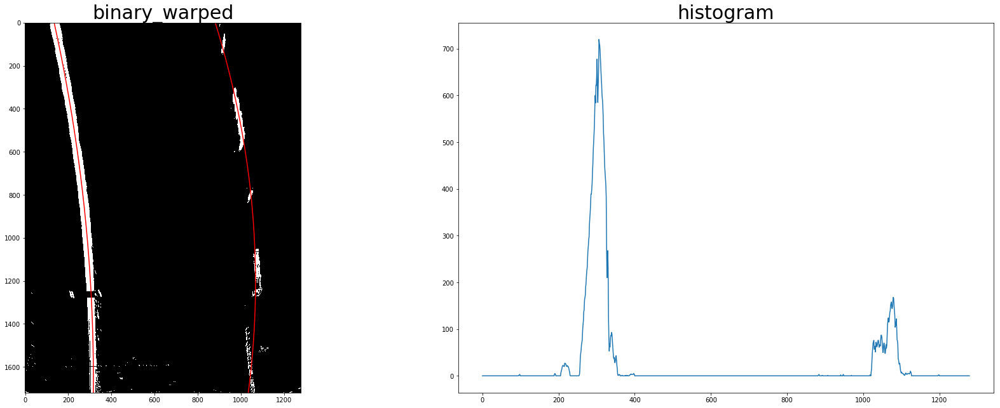

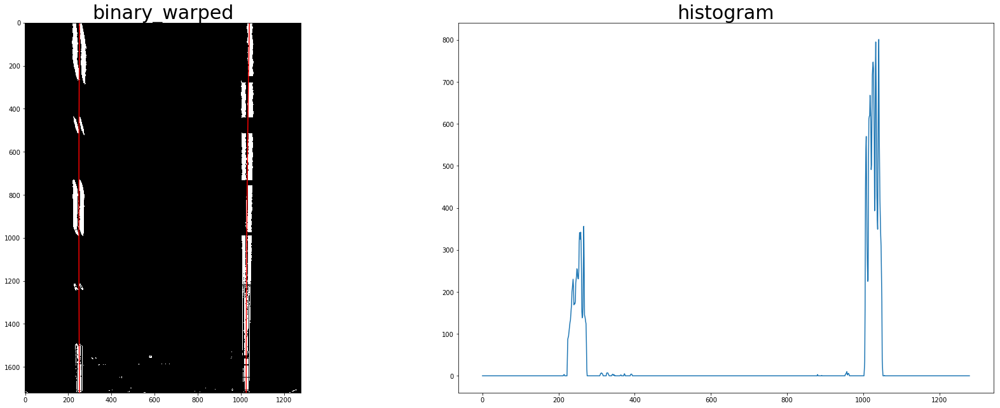

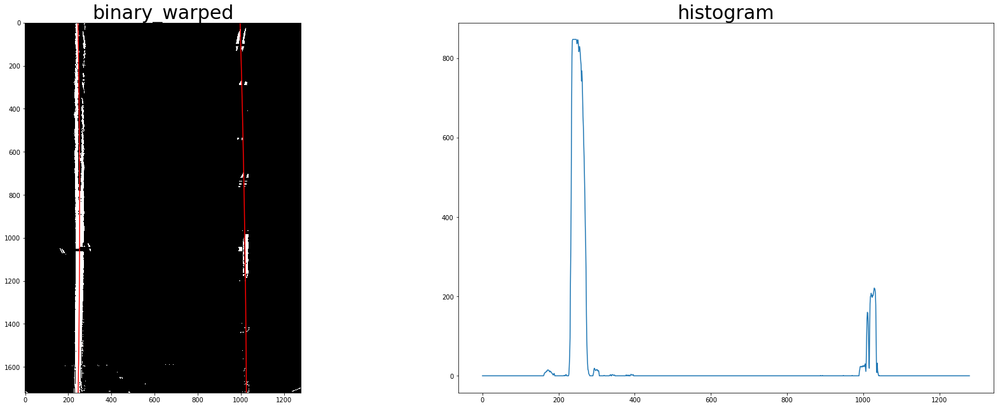

In [16]:
images = glob.glob('./test_images/*.jpg')
for image in images:
    img = mpimg.imread(image)
    undist = cal_undistort(img, objpoints, imgpoints)
    trans = transform_bird_eye(undist)
    gaus = cv2.GaussianBlur(trans, (5, 5), 0)
    binary_warped = get_thresholded_image(gaus)

    (left_fit, right_fit, histogram) = get_lane_lines(binary_warped)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(binary_warped, cmap = "gray")  
    ax1.plot(left_fitx, ploty, color='red')
    ax1.plot(right_fitx, ploty, color='red')
    
    ax1.set_title("binary_warped", fontsize=30)

    ax2.plot(histogram)    
    ax2.set_title("histogram", fontsize=30)

    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Find lane lines from previous
If lane line was detected, I can reuse this knowledge for the next image to faster search.

In [17]:
def get_lane_lines_with_prev(binary_warped, left_fit, right_fit, margin = 50):
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
    right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return (left_fit, right_fit)

## Run current pipeline on test images

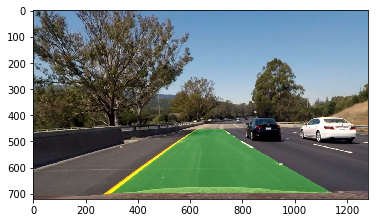

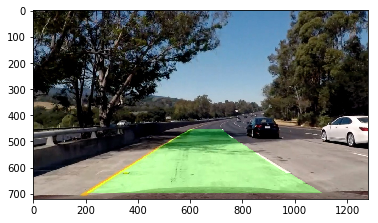

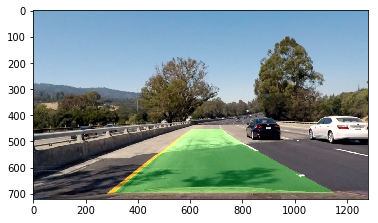

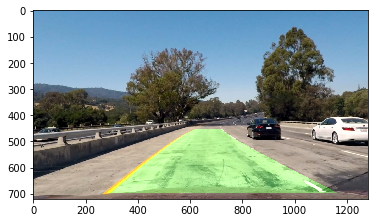

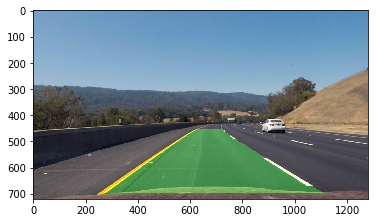

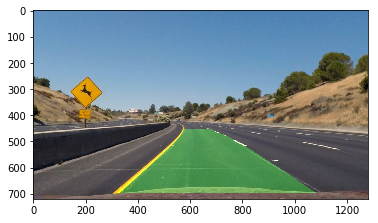

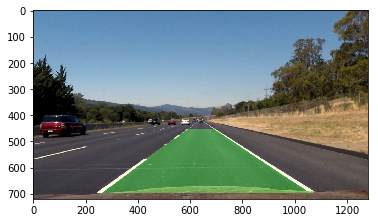

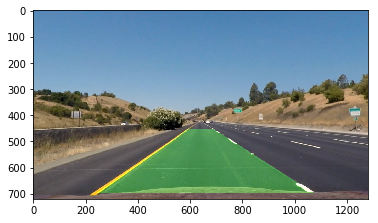

In [18]:
images = glob.glob('./test_images/*.jpg')
for image in images:
    img = mpimg.imread(image)
    undist = cal_undistort(img, objpoints, imgpoints)
    warped = transform_bird_eye(undist)
    gaus = cv2.GaussianBlur(warped, (5, 5), 0)
    binary_warped = get_thresholded_image(gaus)
    #print_two_images(trans, thresholded, "raw", "processed", False, True)
    (left_fit, right_fit, _) = get_lane_lines(binary_warped)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    color_warp = None
    # print an image
    if undist.shape == (720, 1280, 3):
        # Create an image to draw the lines on
        warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
        color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))
   
    if undist.shape == (720, 1280, 4):
        # Create an image to draw the lines on
        warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
        color_warp = np.dstack((warp_zero, warp_zero, warp_zero, warp_zero))

        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = transform_bird_eye(color_warp, True) 
    # Combine the result with the original image
    a = undist
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    plt.imshow(result)
    plt.show()

## Define class Lane
Define Lane class that will help to average lane lines on video

In [19]:
class Lane():
    left_stack = np.empty([0,3])
    right_stack = np.empty([0,3])
    stack_size = 15

    left_average = []
    right_average = []
    left_weighted_average = []
    right_weighted_average = []
    
    ld = np.empty([0,3])
    rd = np.empty([0,3])
        
    def add_lines(self, left_line, right_line):
        
        len_stack = self.left_stack.shape[0]
        
        if len_stack == 0:
            self.left_stack = np.array([left_line])
            self.right_stack = np.array([right_line])
            self.left_average = left_line
            self.right_average = right_line
            self.left_weighted_average = left_line
            self.right_weighted_average = right_line
        else: 
            self.left_stack = np.concatenate((self.left_stack, np.array([left_line])))
            self.right_stack = np.concatenate((self.right_stack, np.array([right_line])))
            if len_stack >= self.stack_size:
                self.left_stack = self.left_stack[1:]
                self.right_stack = self.right_stack[1:]
        
            self.left_average = np.mean(self.left_stack, axis=0)
            self.right_average = np.mean(self.right_stack, axis=0)
            
            left_distance = abs(self.left_average - left_line)
            right_distance = abs(self.right_average - right_line)
            
            self.ld = left_distance
            self.rd = right_distance
            
            left_small_dist = (left_distance[0] < 0.1) & (left_distance[1] < 0.2) & (left_distance[2] < 500)
            right_small_dist = (right_distance[0] < 0.1) & (right_distance[1] < 0.2) & (right_distance[2] < 500)
            
            if left_small_dist:
                self.left_weighted_average = self.left_average
            if right_small_dist:
                self.right_weighted_average = self.right_average
        
    def get_average(self):
        return (self.left_weighted_average, self.right_weighted_average)
    
    def get_last(self):
        cnt = self.left_stack.shape[0]
        if cnt > 0:
            return (self.left_stack[-1], self.right_stack[-1])
        return (np.array([]),np.array([]))
    
    def get_curvative(self):
        mean = np.mean(np.array([self.left_weighted_average, self.right_weighted_average]), axis = 0)
   
        ym_per_pix = 30/1100 # meters per pixel in y dimension
        xm_per_pix = 3.7/660 # meters per pixel in x dimension
        y_eval = 700

        poly_1 = (2*mean[0]*y_eval + mean[1])*xm_per_pix/ym_per_pix
        poly_2 = 2*mean[0]*xm_per_pix/(ym_per_pix*ym_per_pix)

        curvative = ((1 + poly_1**2)**(1.5))/np.absolute(poly_2)
        return curvative
    
    def get_position(self):
        
        ym_per_pix = 30/1100 # meters per pixel in y dimension
        xm_per_pix = 3.7/660 # meters per pixel in x dimension
        y_eval = 700
        
        left_fit = self.left_weighted_average
        right_fit = self.right_weighted_average
        
        x_left = left_fit[0]*(y_eval**2) + left_fit[1]*y_eval + left_fit[2]
        x_right = right_fit[0]*(y_eval**2) + right_fit[1]*y_eval + right_fit[2]
       
        center = (x_left + x_right)/2
        image_center = 1280/2       
 
        position = (image_center - center)*xm_per_pix
        return position
        
    def get_distance(self):
        cnt = self.left_stack.shape[0]
        left = ""
        right = ""
        
        if cnt > 0:
            left = np.array2string(self.ld, precision=2, separator=',', suppress_small=True)
            right = np.array2string(self.rd, precision=2, separator=',', suppress_small=True)
        
        return 'LD: {0}, RD: {1}'.format(left,right)

## Define main pipeline

In [20]:
lane = Lane()

def process_image(img):
    #img = mpimg.imread(image)
    undist = cal_undistort(img, objpoints, imgpoints)
    warped = transform_bird_eye(undist)
    gaus = cv2.GaussianBlur(warped, (5, 5), 0)
    binary_warped = get_thresholded_image(gaus)

    (left_fit, right_fit) = ([],[])
    (left_last, right_last) = lane.get_last()

    if left_last.shape[0] != 3:
        (left_fit, right_fit, _) = get_lane_lines(binary_warped)
    else:
        (left_fit, right_fit) = get_lane_lines_with_prev(binary_warped, left_last, right_last)

    lane.add_lines(left_fit, right_fit)
    
    (left_fit, right_fit) = lane.get_average()
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    radius = lane.get_curvative()
    position = lane.get_position()
    #dist = lane.get_distance()
    
    color_warp = None
    if undist.shape == (720, 1280, 3):
        # Create an image to draw the lines on
        warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
        color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))

    if undist.shape == (720, 1280, 4):
        # Create an image to draw the lines on
        warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
        color_warp = np.dstack((warp_zero, warp_zero, warp_zero, warp_zero))

        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0, 0))

        
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = transform_bird_eye(color_warp, True) 
    # Combine the result with the original image
    a = undist
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    #put additional information
    font = cv2.FONT_HERSHEY_SIMPLEX
    fontScale = 2
    color = (255, 255, 255)
    fontFace = 2
    cv2.putText(result, 'Left curvature: {:.0f} m'.format(radius), (50, 50), font, fontScale, color, fontFace)
    cv2.putText(result, 'Position to lane center: {:.2f} m'.format(position), (50, 150), 
                font, fontScale, color, fontFace)
    #cv2.putText(result, dist, (50, 250), font, fontScale, color, fontFace)
    return result

## Render videos
### Render sample videos

In [21]:
fname = 'test.mp4'
white_output = 'test_videos_output/' + fname
clip1 = VideoFileClip(fname)
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video test_videos_output/test.mp4
[MoviePy] Writing video test_videos_output/test.mp4


 99%|█████████▉| 144/145 [04:44<00:01,  1.95s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/test.mp4 



### Render all videos

In [22]:
fname = 'project_video.mp4'
white_output = 'test_videos_output/' + fname
clip1 = VideoFileClip(fname)
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

fname = 'challenge_video.mp4'
white_output = 'test_videos_output/' + fname
clip1 = VideoFileClip(fname)
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

fname = 'harder_challenge_video.mp4'
white_output = 'test_videos_output/' + fname
clip1 = VideoFileClip(fname)
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video test_videos_output/project_video.mp4
[MoviePy] Writing video test_videos_output/project_video.mp4


100%|█████████▉| 1260/1261 [44:23<00:02,  2.11s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/project_video.mp4 

CPU times: user 43min 52s, sys: 2min 26s, total: 46min 19s
Wall time: 44min 24s
[MoviePy] >>>> Building video test_videos_output/challenge_video.mp4
[MoviePy] Writing video test_videos_output/challenge_video.mp4


100%|██████████| 485/485 [16:53<00:00,  2.10s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/challenge_video.mp4 

CPU times: user 16min 45s, sys: 52.9 s, total: 17min 38s
Wall time: 16min 54s
[MoviePy] >>>> Building video test_videos_output/harder_challenge_video.mp4
[MoviePy] Writing video test_videos_output/harder_challenge_video.mp4


100%|█████████▉| 1199/1200 [41:08<00:02,  2.02s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/harder_challenge_video.mp4 

CPU times: user 40min 45s, sys: 2min 15s, total: 43min
Wall time: 41min 10s
